In [2]:
import matplotlib.pyplot as plt
from scipy import signal
from scipy.io import wavfile
import os
import IPython
import math
import numpy as np
from scipy.signal import medfilt
import sympy
from scipy.sparse import csc_matrix,lil_matrix
import librosa.core as lc
sympy.init_printing()
import IPython.display as ipd
import scipy

In [3]:
base_dir="AudioFiles"
file_1="Degussy - Etude pour les huit doigts.wav"
file_2="Santoro - Paulistana 1.wav"
file_3="Scarlatti - Sonata in A minor, KK 188-inicio.wav"

# Crackle noise

Degussy - Etude pour les huit doigts

In [4]:
file_path = os.path.join(base_dir,file_2)
sample_rate,samples = wavfile.read(file_path)
total_time = 1.0*samples.shape[0]/sample_rate
time = np.array(range(samples.shape[0]))*total_time/samples.shape[0]
sample_rate
IPython.display.Audio(samples[:200000],rate=sample_rate)

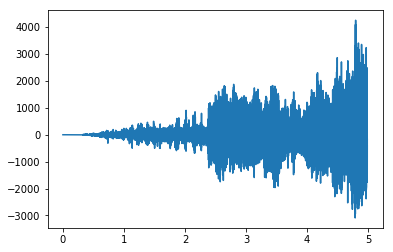

In [5]:
plt.plot(time[:220000],samples[:220000])
plt.show()

In [5]:
time = np.array(range(samples.shape[0]))*samples.shape[0]*1/(1.0*samples.shape[0]/sample_rate)

In [6]:
median_filtered = medfilt(samples,kernel_size=33)
IPython.display.Audio(median_filtered,rate=sample_rate)

In [8]:

def get_X(x,I):
    """
    construct X matrix for autoregressive model as defined in page 34 of
    the thesis
    """
    x_extended = np.zeros((x.shape[0],I))
    X = np.zeros((x.shape[0]-I,I))
    for i in range(I):
        #define selector for each line
        X[:,i] = x[I-i-1:(x.shape[0] -1 - i),0]
    return X

In [9]:
def autoregressive_matrix(x,I):
    """
    Calculate autoregressive model of I coefficients from signal x using LS method
    to minimize the prediction error energy
    """
    print("1")
    X = get_X(x,I)
    print("2")
    X_t = np.transpose(X)
    print("3")
    x_i = x[I:]
    print("4")
    a = np.matmul(X_t,X)
    print("5")
    b = np.linalg.pinv(a)
    print("6")
    c = np.matmul(b,X_t)
    print("7")
    a_ls = np.matmul(c,x_i)
    print("8")
    return a_ls

In [10]:
samples_vector = samples.reshape((samples.shape[0],1))[:200000,:]
print(samples_vector.shape)
I = 100
a = autoregressive_matrix(samples_vector,I)

(200000, 1)
1
2
3
4
5
6
7
8


In [11]:
x_1 = samples_vector[I:,0]

In [12]:
def get_A(a,K):
    """
    construct A matrix as defined in page 124 of the thesis
    """
    I = a.shape[0]
    A = lil_matrix((K-I,K))
    for i in range(K-I):
        A[i,i:i+I] = -1*np.transpose(a)
        A[i,i+I] = 1
    return A

In [13]:
A_filter = np.zeros([I+1])
A_filter[0]= 1
for i in range(I):
    A_filter[i+1] = -a[i]
A_filter

array([ 1.        , -1.62496056,  1.35848608, -1.66449536,  1.95108227,
       -1.93722882,  1.83002149, -2.02868686,  2.06264223, -1.73917667,
        1.69845787, -1.81039686,  1.56476476, -1.25872144,  1.35642514,
       -1.29922687,  0.96415527, -0.86794549,  0.95661741, -0.73580128,
        0.47958695, -0.58544369,  0.57507636, -0.30601487,  0.26711295,
       -0.41104541,  0.25373313, -0.05786814,  0.1900698 , -0.21384715,
       -0.00442192,  0.01419674,  0.14439673, -0.02651209, -0.10646674,
       -0.03129544,  0.08579939,  0.09148623, -0.0873535 , -0.06307706,
       -0.01447438,  0.12225054,  0.01796792, -0.07042716, -0.08161348,
        0.06260484,  0.09124013, -0.0140222 , -0.1003848 , -0.01647446,
        0.07126808,  0.05371812, -0.03782982, -0.08821897,  0.02508395,
        0.07200257,  0.02834004, -0.08379082, -0.03522837,  0.02912838,
        0.07622628, -0.02371471, -0.06562375, -0.0260748 ,  0.07545278,
        0.03348476, -0.03245052, -0.05484847,  0.01270258,  0.06

In [14]:
zi = signal.lfilter_zi(A_filter,[1])
e,_ = signal.lfilter(A_filter,[1],samples_vector[:,0],zi=zi*samples_vector[0,0])

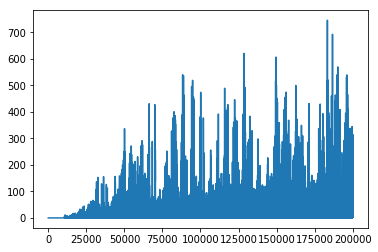

In [40]:
plt.plot(np.abs(e))
plt.show()

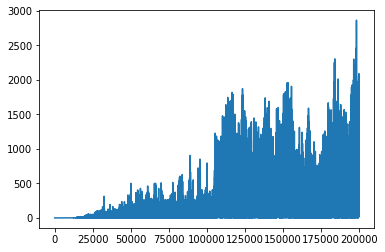

In [41]:
plt.plot(np.abs(samples_vector[:,0]))
plt.show()

In [42]:
zi.shape

In [43]:
A_filter.shape

In [44]:
def ls_interpolation(A_d,A_c,x_c):
    """
    LS interpolation as defined in page 113 of the thesis
    """
    A_d_t = np.transpose(A_d)
    x_d = np.matmul(np.matmul(np.matmul(np.pinv(np.matmul(A_d_t,A_d)),A_d_t),A_c),x_c)
    return x_d

In [56]:
#values taken from page 130
I = 100
a = autoregressive_matrix(samples_vector,I)

K=samples_vector.shape[0]
A = get_A(a,K)
sigma_e = np.std(e)
C = 1
beta = 0.5
lamb = C*sigma_e

1
2
3
4
5
6
7
8


In [57]:
choice_matrix = e > lamb


In [58]:
def find_indices(lst, condition):
    return [i for i, elem in enumerate(lst) if condition(elem)]

In [59]:
e.shape
choice_matrix.shape
indices = find_indices(choice_matrix,lambda x : x == True)

In [60]:
A.shape

In [61]:
len(indices)

In [62]:
A_d = A[:,indices]


KeyboardInterrupt: 

In [ ]:
x_d = samples_vector[choice_matrix]


In [ ]:
choice_matrix = x <= lamb


In [315]:
A_c = A[:,choice_matrix]


In [ ]:
x_c = samples_vector[choice_matrix]

/Users/danielmendonca/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_axes.py:7221: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


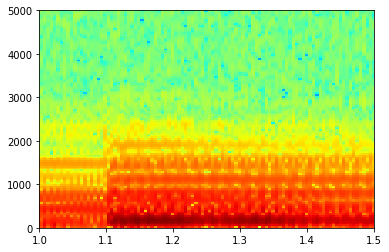

In [10]:
window_length=0.01 #20ms, minimum variation we (humans) can hear
nfft=int(window_length*sample_rate)
plt.specgram(samples[:200000], Fs=sample_rate,cmap='jet',NFFT=nfft,noverlap=nfft/2,pad_to=1048)
plt.ylim(0,5000)
plt.xlim(1,1.5)
plt.show()


In [127]:
stftMat.shape

In [92]:
window_length=0.02 #20ms, minimum variation we (humans) can hear
nfft=int(window_length*sample_rate)

stftMat = lc.stft(samples/1.0, n_fft=nfft)

/Users/danielmendonca/anaconda3/lib/python3.6/site-packages/numpy/core/numeric.py:501: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


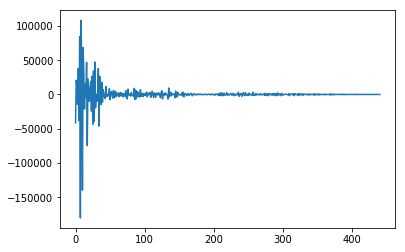

In [93]:
plt.plot(stftMat[:,16000],)
plt.show()


In [100]:
stftMat = lc.stft(samples/1.0, n_fft=nfft)
for i in range(stftMat.shape[1]):
    if(np.argmax(stftMat[1:,i]) > 20):
        print(np.argmax(stftMat[1:,i]))
        stftMat[:,i] = 0.0*stftMat[:,i]
filtered = lc.istft(stftMat)


123
77
60
72
108
59
28
59
24
24
24
22
22
25
26
23
24
23
23
23
24
24
23
23
23
23
23
23
22
24
23
23
24
24
23
23
29
27
27
21
22
21
27
27
27
27
27
27
22
23
24
24
24
24
22
21
22
21
22
21
22
21
21
22
21
22
22
21
22
21
22
21
21
21
22
21
22
22
21
22
21
21
21
21
22
22
22
21
21
23
27
27
22
22
23
24
25
24
25
24
24
26
26
26
28
28
28
28
28
28
28
28
24
26
22
27
27
27
24
27
27
24
24
25
25
24
28
25
28
24
28
25
28
27
27
27
27
27
24
36
23
24
24
27
27
27
27
36
33
33
27
27
27
27
27
22
24
24
24
24
24
36
22
23
23
22
22
23
22
22
23
21
23
25
25
23
23
22
22
36
22
23
22
23
23
22
23
22
23
23
22
22
22
25
23
23
22
32
22
22
22
30
22
22
22
22
29
29
23
25
36
22
22
22
22
22
22
23
32
22
22
44
43
29
44
29
44
29
45
29
44
37
29
29
36
37
37
37
37
36
37
45
37
36
44
37
36
37
43
37
44
44
21
62
62
63
63
57
56
56
55
53
56
53
47
47
47
47
52
46
46
46
41
47
39
39
39
41
38
34
38
38
35
30
34
31
28
28
28
28
30
26
26
53
26
23
23
23
27
27
27
27
27
27
27
32
21
27
24
27
36
30
78
57
36
27
24
24
24
25
26
24
28
22
23
24
33
23
24
22
21
22
24

In [101]:
ipd.Audio(filtered,rate=sample_rate)

In [105]:
IPython.display.Audio(samples,rate=sample_rate)

In [ ]:
kkk = samples_vector - e